<a href="https://colab.research.google.com/github/andypykee/andypykee.github.io/blob/main/pybibX_Biblio_content_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
############################################################################

# Created by: Prof. Valdecy Pereira, D.Sc.
# UFF - Universidade Federal Fluminense (Brazil)
# email:  valdecy.pereira@gmail.com
# pyBibX - A Bibliometric and Scientometric Library
# Example - Use your own .bib

# Citation:
# PEREIRA, V.; BASILIO, M.P.; SANTOS, C.H.T. (2025). PyBibX: A Python Library for Bibliometric and
# Scientometric Analysis Powered with Artificial Intelligence Tools. Data Technologies and Applications.
# Vol. ahead-of-print No. ahead-of-print. doi: https://doi.org/10.1108/DTA-08-2023-0461

############################################################################

In [1]:
# Restart the session afther this cell to avoid Google Colab errors
!pip install --upgrade --force-reinstall numpy==1.26.4 pandas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 619.7 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 78.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 81.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.9/229.9 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 509.2/509.2 kB 33.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 347.8/347.8 kB 19.7 MB/s eta 0:00:00
  Attempting uninstall: pytz
    Found existing installation: pytz 2025.2
    Uninstalling pytz-2025.2:
      Successfully uninstalled pytz-2025.2
  Attempting uninstall: tzdata
    Found existing installation: tzdata 2025.2
    Uninstalling tzdata-2025.2:
      Successfully uninstalled tzdata-2025.2
  Attempting uninstall: six
    Found existing installation: six 1.17.0
    Uninstalling six-1.17.0:
      Successfully uninstalled six-

In [1]:
!pip install pybibx
!pip install tabulate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 4.1 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of thinc to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.3/110.3 kB 10.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.6/150.6 kB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 113.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 93.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 M

In [2]:
# Required Libraries
import numpy as np
import pandas as pd
import textwrap

from google.colab import data_table
from google.colab import files
from tabulate import tabulate
from prettytable import PrettyTable
from pybibx.base import pbx_probe


In [3]:
# Dowload .bib files
!wget https://raw.githubusercontent.com/andypykee/pybibx/refs/heads/main/assets/bib/scoA.bib
!wget https://raw.githubusercontent.com/andypykee/pybibx/refs/heads/main/assets/bib/woscienceA.bib
!wget https://raw.githubusercontent.com/andypykee/pybibx/refs/heads/main/assets/bib/woscienceB.bib

--2025-04-13 08:34:18--  https://raw.githubusercontent.com/andypykee/pybibx/refs/heads/main/assets/bib/scoA.bib
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 9180529 (8.8M) [text/plain]
Saving to: ‘scoA.bib’

scoA.bib            100%[===================>]   8.75M  --.-KB/s    in 0.06s   

2025-04-13 08:34:19 (143 MB/s) - ‘scoA.bib’ saved [9180529/9180529]

--2025-04-13 08:34:19--  https://raw.githubusercontent.com/andypykee/pybibx/refs/heads/main/assets/bib/woscienceA.bib
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6459632 (

# Load Dataset
---
In this section, we will load and inspect the dataset.

In [4]:
# Load .bib
# Arguments: file_bib = 'filename.bib'; db = 'scopus', 'wos', 'pubmed'; del_duplicated = True, False
file_name = 'scoA.bib'
database  = 'scopus'
bibfile   = pbx_probe(file_bib = file_name, db = database, del_duplicated = True)

A Total of 3215 Documents were Found ( 3255 Documents and 40 Duplicates )

Article = 715
Book = 5
Book chapter = 72
Conference paper = 2241
Conference review = 155
Retracted = 1
Review = 26


In [5]:
# Merge Database
file_name_ = 'woscienceA.bib'
database_  = 'wos'
bibfile.merge_database(file_bib = file_name_, db = database_, del_duplicated = True)

############################################################################

Original Database

A Total of 3215 Documents were Found ( 3255 Documents and 40 Duplicates )

Article = 715
Book = 5
Book chapter = 72
Conference paper = 2241
Conference review = 155
Retracted = 1
Review = 26

############################################################################

Added Database

A Total of 1000 Documents were Found ( 1000 Documents and 0 Duplicates )

Article = 326
Article in Press = 13
Article; Retracted Publication = 2
Proceedings Paper = 641
Review = 17
Review; Early Access = 1

############################################################################

Merging Information:

A Total of 3351 Documents were Found ( 136 New Documents from the Added Database )

Article  =  741
Article in Press  =  9
Article; Retracted Publication  =  1
Book  =  5
Book chapter  =  72
Conference paper  =  2241
Conference review  =  155
Proceedings Paper  =  94
Retracted  =  1
Review  =  32

############

In [6]:
# Merge Database
file_name_ = 'woscienceB.bib'
database_  = 'wos'
bibfile.merge_database(file_bib = file_name_, db = database_, del_duplicated = True)

############################################################################

Original Database

A Total of 3351 Documents were Found
Article = 741
Article in Press = 9
Article; Retracted Publication = 1
Book = 5
Book chapter = 72
Conference paper = 2241
Conference review = 155
Proceedings Paper = 94
Retracted = 1
Review = 32

############################################################################

Added Database

A Total of 158 Documents were Found ( 158 Documents and 0 Duplicates )

Article = 89
Article in Press = 6
Proceedings Paper = 60
Review = 3

############################################################################

Merging Information:

A Total of 3374 Documents were Found ( 23 New Documents from the Added Database )

Article  =  751
Article in Press  =  10
Article; Retracted Publication  =  1
Book  =  5
Book chapter  =  72
Conference paper  =  2241
Conference review  =  155
Proceedings Paper  =  106
Retracted  =  1
Review  =  32

####################################

In [7]:
# Health Analysis
health = bibfile.health_bib()

# Check Health
health

,Entries,Completeness (%),Number of Docs
0,Sources,96.86%,3268
1,Abstracts,99.85%,3369
2,Affiliation,100.00%,3374
3,Author(s),95.44%,3220
4,DOI,69.35%,2340
5,Keywords - Authors,72.73%,2454
6,Keywords - Plus,82.34%,2778
7,References,4.71%,159
8,Year,100.00%,3374


In [8]:
# Generate EDA (Exploratory Data Analysis) Report
report  = bibfile.eda_bib()

# Check Report
report

,Main Information,Results
0,Timespan,2006-2025
1,Total Number of Countries,103
2,Total Number of Institutions,4102
3,Total Number of Sources,1056
4,Total Number of References,4998
5,Total Number of Languages,1
6,--english (# of docs),3374
7,-//-,-//-
8,Total Number of Documents,3374
9,--Article,751


In [9]:
# The metadata can be reviewed and manually modified. If you need to make adjustments, you can directly edit the bibfile.data, which is a DataFrame containing all the utilized information.
print(tabulate(bibfile.data.head(n = 10), headers = 'keys', tablefmt = 'psql'))
# Modify 'bibfile.data' as needed.

+----+-------------------------------------------------------------------------------+--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [10]:
# Check Docs IDs
data_table.DataTable(bibfile.table_id_doc, num_rows_per_page = 15)

,ID,Document
0,0,"Azar, Ahmad Taher and Noori, Harith Muthanna a..."
1,1,"Agarwal, Vibhor and Chen, Yu and Sastry, Nisha..."
2,2,"Su, Xuanyu and Li, Yansong and Branco, Paula a..."
3,3,"P.Y.K.L, Srinivas and Das, Amitava and Pulabai..."
4,4,"Pandey, Ajeet and Kumar, Piyush (2024). Ressta..."
...,...,...
3369,3369,"Mihaylov, Todor and Mihaylova, Tsvetomila and ..."
3370,3370,"Vizcarra, Julio and Fukuda, Ken and Kozaki, Ko..."
3371,3371,"Maity, Krishanu and Jain, Raghav and Jha, Prin..."
3372,3372,"Poddar, Soham and Mukherjee, Rajdeep and Samad..."


In [11]:
# Check Docs IDs per Type
data_table.DataTable(bibfile.id_doc_types(), num_rows_per_page = 15)

,Document Types,IDs
0,Article,"[0, 1, 2, 3, 4, 5, 10, 11, 12, 13, 14, 17, 18,..."
1,Article in Press,"[3221, 3247, 3253, 3268, 3277, 3288, 3298, 332..."
2,Article; Retracted Publication,[3265]
3,Book,"[6, 37, 176, 344, 461]"
4,Book chapter,"[8, 114, 167, 170, 333, 338, 341, 347, 369, 37..."
5,Conference paper,"[9, 15, 16, 23, 26, 29, 69, 72, 77, 101, 102, ..."
6,Conference review,"[132, 134, 139, 168, 201, 255, 266, 304, 343, ..."
7,Proceedings Paper,"[3215, 3216, 3218, 3219, 3220, 3222, 3223, 322..."
8,Retracted,[1619]
9,Review,"[7, 28, 64, 90, 92, 129, 222, 429, 598, 690, 6..."


In [12]:
# Check Authors IDs
data_table.DataTable(bibfile.table_id_aut, num_rows_per_page = 15)

,ID,Author
0,a_0,"a'la, fiddin yusfida"
1,a_1,"a, julia"
2,a_2,"aarthi, b."
3,a_3,"ababu, teshome mulugeta"
4,a_4,"abadou, sofiane"
...,...,...
8671,a_8671,"škrlj, blaž"
8672,a_8672,"šnajder, jan"
8673,a_8673,"šuppa, marek"
8674,a_8674,"švec, andrej"


In [13]:
# These indices are local (considers only the .bib scope)
# H-index measures their academic impact by identifying the number of papers (h) that have each received at least h citations
# E-Index quatifies excess citations within the H-core revealing "hidden" impact beyond the H-index threshold.
# The G-Index emphasizes highly cited work, making it sensitive to breakthrough publications.
# The M-Index contextualizes the H-index by normalizing it over the researcher’s career duration
aut_m = bibfile.m_index(2022)
df_idx = {
    'Author': bibfile.u_aut,
    'H-index': bibfile.aut_h,
    'E-Index': bibfile.aut_e,
    'G-Index': bibfile.aut_g,
    'M-Index': aut_m
}

df_idx = pd.DataFrame(df_idx)
df_idx

,Author,H-index,E-Index,G-Index,M-Index
0,"a'la, fiddin yusfida",1,1.732051,1,1.0
1,"a, julia",1,0.000000,1,1.0
2,"aarthi, b.",1,1.000000,1,1.0
3,"ababu, teshome mulugeta",1,1.000000,1,1.0
4,"abadou, sofiane",1,0.000000,1,1.0
...,...,...,...,...,...
8671,"škrlj, blaž",2,5.656854,2,0.5
8672,"šnajder, jan",1,7.681146,1,0.2
8673,"šuppa, marek",1,1.000000,1,1.0
8674,"švec, andrej",1,1.000000,1,1.0


In [14]:
# Check Sources IDs
data_table.DataTable(bibfile.table_id_jou, num_rows_per_page = 15)

,ID,Source
0,j_0,ceur workshop proc.
1,j_1,lect. notes comput. sci.
2,j_2,lect. notes networks syst.
3,j_3,commun. comput. info. sci.
4,j_4,acm int. conf. proc. ser.
...,...,...
1051,j_1051,acm trans. asian low-resour. lang. inf. process.
1052,j_1052,"acis - australas. conf. inf. syst., proc."
1053,j_1053,access control and secur. monit. of multimed. ...
1054,j_1054,3c tic


In [15]:
# Check Institutions IDs
data_table.DataTable(bibfile.table_id_uni, num_rows_per_page = 15)

,ID,Institution
0,i_0,independent researcher
1,i_1,meriem laboratory of informatics and its appli...
2,i_2,xiaochao xinjiang normal university
3,i_3,majmmah university
4,i_4,south eastern university of sri lanka
...,...,...
4097,i_4097,int inst informat technol
4098,i_4098,kevin b. school of engineering and sciences
4099,i_4099,aigerim international information technology u...
4100,i_4100,deepali nilesh pimpri chinchwad college of eng...


In [16]:
# Check Countries IDs
data_table.DataTable(bibfile.table_id_ctr, num_rows_per_page = 15)

,ID,Country
0,c_0,Sudan
1,c_1,Albania
2,c_2,Ghana
3,c_3,Thailand
4,c_4,Eritrea
...,...,...
98,c_98,Niger
99,c_99,Uganda
100,c_100,Israel
101,c_101,Australia


In [17]:
# Check Authors Keywords IDs
data_table.DataTable(bibfile.table_id_kwa, num_rows_per_page = 15)

,ID,KWA
0,k_0,hate speech
1,k_1,machine learning
2,k_2,deep learning
3,k_3,hate speech detection
4,k_4,natural language processing
...,...,...
4157,k_4157,1. introduction
4158,k_4158,- abusive language detection
4159,k_4159,(near) real-time
4160,k_4160,(im)politeness


In [18]:
# Check Keywords Plus IDs
data_table.DataTable(bibfile.table_id_kwp, num_rows_per_page = 15)

,ID,KWP
0,p_0,social networking (online)
1,p_1,speech recognition
2,p_2,social media
3,p_3,speech detection
4,p_4,deep learning
...,...,...
7629,p_7629,- abusive language detection
7630,p_7630,(im)politeness
7631,p_7631,(b stand for beginning i for inside o for outs...
7632,p_7632,'lacuna'


In [19]:
# Check Reference IDs (If References are Given)
df = pd.DataFrame({'Reference': bibfile.u_ref, 'Reference ID': bibfile.u_ref_id})
data_table.DataTable(df, num_rows_per_page = 15)

,Reference,Reference ID
0,"ADL, 2019, FREE PLAY HAT HAR PO.",r_0
1,"AL-Ani MM, 2021, J COMPUT SCI-NETH, V17, P1093...",r_1
2,"ALREHAN AM, 2019, 2019 IEEE ACS 16 INT.",r_2
3,"ANSA, 2021, SYR TEMP PROT TURK T.",r_3
4,"Abadani Negin, 2021, 2021 7th International Co...",r_4
...,...,...
4993,"van der Laan MJ, 2007, STAT APPL GENET MOL, V6...",r_4993
4994,"Çöltekin Ç, 2020, PROCEEDINGS OF THE 12TH INTE...",r_4994
4995,"Özdemir A, 2020, PROCEEDINGS OF THE FOURTEENTH...",r_4995
4996,"Özel SA, 2017, 2017 INTERNATIONAL CONFERENCE O...",r_4996


# Exploratory Data Analysis
---
In this section, we will perform EDA

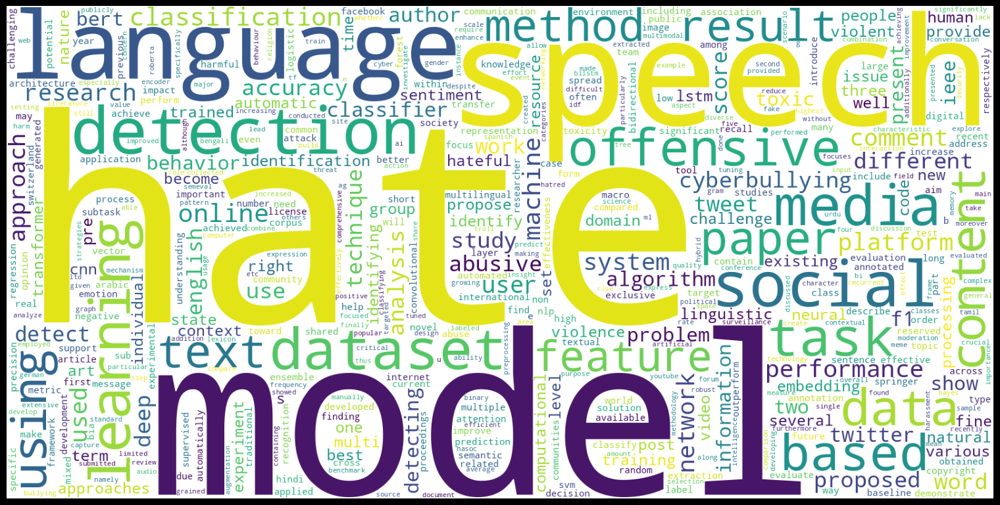

In [20]:
# WordCloud from the Abstracts, Title, Authors Keywords or Keywords Plus
# Arguments: entry             = 'abs', 'title', 'kwa', or 'kwp'
#            rmv_custom_words  = A list of custom stopwords to clean the corpus;
bibfile.word_cloud_plot(entry = 'abs', size_x = 15, size_y = 10, wordsn = 500, rmv_custom_words = [])

In [21]:
# Check Table
num_columns = 5
data_wd     = bibfile.ask_gpt_wd
items       = list(data_wd.items())

field_names = []
for i in range(num_columns):
    field_names.append(f"Word {i + 1}")
    field_names.append(f"Importance {i + 1}")

table = PrettyTable()
table.field_names = field_names

for i in range(0, len(items), num_columns):
    row = []
    for j in range(num_columns):
        if i + j < len(items):
            word, importance = items[i + j]
            row.extend([word, round(importance, 4)])
        else:
            row.extend(["", ""])
    table.add_row(row)

# Print the table
print(table)

+----------------+--------------+----------------+--------------+---------------+--------------+----------------+--------------+----------------+--------------+
|     Word 1     | Importance 1 |     Word 2     | Importance 2 |     Word 3    | Importance 3 |     Word 4     | Importance 4 |     Word 5     | Importance 5 |
+----------------+--------------+----------------+--------------+---------------+--------------+----------------+--------------+----------------+--------------+
|      hate      |     1.0      |     model      |    0.9511    |     speech    |    0.9271    |    language    |    0.7635    |   detection    |    0.6492    |
|     social     |    0.6113    |    dataset     |    0.4857    |     media     |    0.4772    |    learning    |    0.4744    |      task      |    0.4238    |
|   offensive    |    0.3814    |      data      |    0.3712    |     based     |    0.3651    |    content     |    0.3599    |     using      |    0.3416    |
|     paper      |    0.3239    | 

In [22]:
# N-Grams
# Arguments: view       = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            entry      = 'abs', 'title', 'kwa', or 'kwp'
#            n_grams    = An integer with size n (representing the most common groups of words with size n)
#            stop_words = A list of stopwords to clean the corpus. ['ar', 'bn', 'bg', 'cs', 'en', 'fi', 'fr', 'de', 'el', 'hi', 'he', 'hu', 'it', 'ja', 'ko',  'mr', 'fa', 'pl', 'pt-br', 'ro', 'ru', 'es', 'sv', 'sk', 'zh', 'th', 'uk'];
#                         'ar' = Arabic; 'bn' = Bengali; 'bg' = Bulgarian; 'cs' = Czech; 'en' = English; 'fi' = Finnish; 'fr' = French; 'de' = German; 'el' = Greek; 'he' = Hebrew;'hi' = Hindi; 'hu' = Hungarian; 'it' = Italian;
#                         'ja' = Japanese; 'ko' = Korean; 'mr' =  Marathi; 'fa' =  Persian; 'pl' =  Polish; 'pt-br' = Potuguese-Brazilian; 'ro' = Romanian; 'ru' = Russian; 'es' =  Spanish; 'sk' = Slovak; 'sv' = Swedish;
#                         'zh' = Chinese; 'th' = Thai; 'uk' = Ukrainian
#            rmv_custom_words  = A list of custom stopwords to clean the corpus
#             wordsn           = Number of N-Grams
bibfile.get_top_ngrams(view = 'notebook', entry = 'kwp', ngrams = 3, stop_words = [], rmv_custom_words = [], wordsn = 15)

In [23]:
# Check Table
data_ng = bibfile.ask_gpt_ng
data_table.DataTable(data_ng, num_rows_per_page = 15)

,Word,Freq
0,social networking online,1248
1,natural language processing,943
2,classification of information,639
3,language processing systems,624
4,networking online speech,406
5,language processing natural,353
6,short term memory,347
7,long short term,330
8,social media platforms,295
9,social media speech,287


In [24]:
# Documents Projection based on Words. (An interactive plot). It returns the Projection (each document coordinate) and the Labels (each document cluster)
# Arguments: view              = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            corpus_type       = 'abs', 'title', 'kwa', or 'kwp';
#            stop_words        = A list of stopwords to clean the corpus. ['ar', 'bn', 'bg', 'cs', 'en', 'fi', 'fr', 'de', 'el', 'hi', 'he', 'hu', 'it', 'ja', 'ko',  'mr', 'fa', 'pl', 'pt-br', 'ro', 'ru', 'es', 'sv', 'sk', 'zh', 'th', 'uk'];
#                                'ar' = Arabic; 'bn' = Bengali; 'bg' = Bulgarian; 'cs' = Czech; 'en' = English; 'fi' = Finnish; 'fr' = French; 'de' = German; 'el' = Greek; 'he' = Hebrew;'hi' = Hindi; 'hu' = Hungarian; 'it' = Italian;
#                                'ja' = Japanese; 'ko' = Korean; 'mr' =  Marathi; 'fa' =  Persian; 'pl' =  Polish; 'pt-br' = Potuguese-Brazilian; 'ro' = Romanian; 'ru' = Russian; 'es' =  Spanish; 'sk' = Slovak; 'sv' = Swedish;
#                                'zh' = Chinese; 'th' = Thai; 'uk' = Ukrainian
#            rmv_custom_words  = A list of custom stopwords to clean the corpus;
#            custom_label      = A list of custom labels for each document. The user can define each document cluster;
#            custom_projection = A list of custom coordinates for each document. The user can define each document coordinate;
#            n_components      = Number of Dimensions;
#            n_clusters        = Only relevant if  cluster_method = 'kmeans'.Number of Clusters.;
#            node_labels       = If True, labels appear in nodes;
#            node_size         = Node size;
#            node_font_size    = Node font size;
#            tf_idf            = True or False (True -> The Cluster Algorithm will use the DTM to calculate each document Label. False -> The Cluster Algorithm will use the Coordinates to calculate each document Label);
#            embeddings        = True or False (True -> The Cluster Algorithm will use the Word Embeddings to calculate each document Label. False -> The Cluster Algorithm will use the Coordinates to calculate each document Label);
#            model             = Only relevant if 'embeddings = True'. Specifies the used AI model. The default value is 'allenai/scibert_scivocab_uncased';
#            method            = 'tsvd' or 'umap' ('tsvd' -> Truncated SVD projection method is used. 'umap' -> UMAP projection method is used);
#            showlegend        = If True, shows legend;
#            cluster_method    = 'kmeans' or 'hdbscan';
#            min_size          = Only relevant if  cluster_method = 'hdbscan'. Minimum number of elements in a Cluster;
#            max_size          = Only relevant if  cluster_method = 'hdbscan'. Maximum number of elements in a Cluster
projection, labels = bibfile.docs_projection(view              = 'notebook',
                                             corpus_type       = 'abs',
                                             stop_words        = ['en'],
                                             rmv_custom_words  = [],
                                             custom_label      = [],
                                             custom_projection = [],
                                             n_components      = 2,
                                             n_clusters        = 5,
                                             node_labels       = True,
                                             node_size         = 12,
                                             node_font_size    = 5,
                                             tf_idf            = False,
                                             embeddings        = False,
                                             model             = 'allenai/scibert_scivocab_uncased',
                                             method            = 'umap',
                                             showlegend        = True,
                                             cluster_method    = 'kmeans',
                                             min_size          = 5,
                                             max_size          = 50
                                             )

In [27]:
# Check Table
data_pr = pd.DataFrame(np.hstack([projection, labels.reshape(-1,1)]))
data_table.DataTable(data_pr, num_rows_per_page = 15)

,0,1,2
0,6.725437,10.828589,4.0
1,8.138016,7.350611,1.0
2,10.904721,9.455590,0.0
3,6.698256,8.907944,2.0
4,3.903474,7.420056,2.0
...,...,...,...
3369,6.000875,9.137856,2.0
3370,9.870929,6.872756,1.0
3371,10.969030,6.565355,1.0
3372,10.807057,7.114666,1.0


In [28]:
# Check Articles per Cluster
cluster      = 0
idx_articles = [i for i in range(0, labels.shape[0]) if labels[i] == cluster]
print(*idx_articles, sep = ', ')

2, 6, 7, 10, 15, 17, 21, 23, 24, 33, 34, 35, 37, 38, 41, 44, 47, 48, 50, 52, 53, 55, 57, 58, 60, 64, 68, 76, 79, 82, 83, 84, 88, 89, 90, 91, 94, 95, 99, 102, 109, 110, 111, 112, 116, 117, 118, 120, 121, 122, 123, 124, 126, 130, 134, 137, 138, 140, 143, 146, 148, 152, 156, 159, 160, 161, 162, 165, 169, 171, 173, 177, 180, 185, 186, 187, 190, 191, 195, 197, 210, 211, 212, 217, 219, 222, 223, 225, 226, 229, 231, 235, 236, 237, 239, 240, 246, 247, 251, 252, 259, 263, 267, 268, 269, 270, 273, 274, 275, 276, 280, 281, 282, 283, 284, 285, 288, 292, 293, 294, 301, 303, 305, 306, 313, 314, 315, 318, 324, 327, 328, 330, 331, 335, 337, 339, 342, 346, 353, 354, 358, 363, 364, 365, 367, 370, 371, 372, 376, 382, 395, 396, 399, 400, 404, 406, 409, 410, 421, 422, 426, 427, 429, 434, 443, 453, 455, 457, 463, 464, 466, 472, 473, 474, 475, 476, 478, 481, 482, 484, 487, 502, 504, 505, 509, 510, 513, 515, 517, 522, 525, 532, 533, 542, 546, 550, 554, 555, 556, 557, 566, 567, 571, 572, 573, 574, 576, 578, 58

In [29]:
# Arguments: view              = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            key               = 'abs', 'title', 'jou, 'kwa', or 'kwp';
#            stop_words        = A list of stopwords to clean the corpus. ['ar', 'bn', 'bg', 'cs', 'en', 'fi', 'fr', 'de', 'el', 'hi', 'he', 'hu', 'it', 'ja', 'ko',  'mr', 'fa', 'pl', 'pt-br', 'ro', 'ru', 'es', 'sv', 'sk', 'zh', 'th', 'uk'];
#                                'ar' = Arabic; 'bn' = Bengali; 'bg' = Bulgarian; 'cs' = Czech; 'en' = English; 'fi' = Finnish; 'fr' = French; 'de' = German; 'el' = Greek; 'he' = Hebrew;'hi' = Hindi; 'hu' = Hungarian; 'it' = Italian;
#                                'ja' = Japanese; 'ko' = Korean; 'mr' =  Marathi; 'fa' =  Persian; 'pl' =  Polish; 'pt-br' = Potuguese-Brazilian; 'ro' = Romanian; 'ru' = Russian; 'es' =  Spanish; 'sk' = Slovak; 'sv' = Swedish;
#                                'zh' = Chinese; 'th' = Thai; 'uk' = Ukrainian
#            rmv_custom_words  = A list of custom stopwords to clean the corpus;
#            topn              = Total number entities;
#            txt_font_size     = Font size of the text inside the bins;
#            start             = Start Year; -1 = all years
#            end               = End Year;   -1 = all years
bibfile.plot_evolution_year(view             = 'notebook',
                            stop_words       = ['en'],
                            rmv_custom_words = [],
                            key              = 'abs',
                            topn             = 10,
                            txt_font_size    = 12,
                            start            = 2007,
                            end              = 2024)

In [30]:
# View Table
data_ep = bibfile.ask_gpt_ep
print(textwrap.fill(data_ep, 150))

 2007: system (3), results (3), study (3), detection (3), violent (3), network (2), problem (2), show (2), security (2), content (2) 2008: confidences
(1), learning (1), data (1), typical (1), modified (1), exploited (1), outputs (1), universal (1), manage (1), transform (1) 2009: detect (2), violent
(2), improve (2), identifying (2), training (2), data (2), approach (2), based (2), classification (2), content (2) 2010: classification (6), results
(5), based (4), paper (4), approach (4), detect (4), method (4), violent (4), ieee (4), data (3) 2011: motion (3), finally (3), information (3),
proposed (3), approach (3), task (3), paper (3), video (3), content (3), algorithm (3) 2012: approach (5), propose (3), offensive (3), language (3),
detection (3), features (3), detecting (3), content (3), hand (2), empirical (2) 2013: paper (6), detecting (5), detect (5), information (5), data
(4), results (4), approach (4), based (4), content (4), features (3) 2014: detection (6), approach (5), res

In [31]:
# Arguments: view              = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            topn              = Most frequent n words
#            custom            = Plot specific words
bibfile.plot_evolution_year_complement(data_ep, view = 'notebook', topn = 10, custom = [])

In [32]:
# Sankey Diagram (An interactive plot)
# Arguments:
#   view         : Determines the rendering mode.'notebook' -> Plots in your preferred Notebook app. 'browser'  -> Plots in your preferred browser window.
#   entry        : A list defining the sequence of data columns to be visualized. Allowed keys: 'aut', 'cout', 'inst', 'jou', 'kwa', 'kwp', 'lan'
#   rmv_unknowns : Boolean flag controlling how unknown entries are handled. True  -> Remove any relationships that include 'unknown'.
#   topn         : Specifies the maximum number of top entities/connections to display at each level. Set to "None" for no filtering or provide a list with limits corresponding to each connection between the nodes defined in 'entry'.
bibfile.sankey_diagram(view = 'notebook', entry = ['aut', 'cout', 'lan'], topn = [3, 5], rmv_unknowns = True)

# PS: The white bars can be dragged

In [33]:
# View Table
data_sk = bibfile.ask_gpt_sk
data_table.DataTable(data_sk, num_rows_per_page = 15)

,Node From,Node To,Connection Weigth
0,"zampieri, marcos",United States of America,22
1,"zampieri, marcos",United Kingdom,7
2,"zampieri, marcos",India,2
3,"zampieri, marcos",Qatar,1
4,"ranasinghe, tharindu",United Kingdom,25
5,"ranasinghe, tharindu",United States of America,2
6,United States of America,english,1244
7,United Kingdom,english,443
8,India,english,2948
9,Qatar,english,62


In [34]:
# Plot Count Y per X (An interactive bar chart)
# Arguments:
#   view          : Determines where the plot will be rendered. 'browser'  -> Plots in your preferred browser window. 'notebook' -> (if supported) Plots within your notebook environment.
#   rmv_unknowns  : Boolean flag to handle unknown entries. True  -> Removes any relationships containing unknown values.
#   x             : The key (column) to use for the X-axis. Must be one of: 'aut', 'cout', 'inst', 'jou', 'kwa', 'kwp', 'lan'. Default is 'cout'.
#   y             : The key (column) to use for the Y-axis. Must be one of: 'aut', 'cout', 'inst', 'jou', 'kwa', 'kwp', 'lan'. Default is 'aut'.
#   topn_x        : Maximum number of top X categories (based on total counts) to display. Default is 5.
#   topn_y        : Maximum number of top Y entries (per X category) to display. Default is 5.
#   text_font_size: Font size for the text labels displayed inside the bars. Default is 12.
#   x_angle       : Angle (in degrees) for the X-axis tick labels. Default is -90 (rotating labels vertically).
bibfile.plot_count_y_per_x(view = 'notebook', rmv_unknowns = True, x = 'cout', y = 'aut', topn_x = 5, topn_y = 5, text_font_size = 12, x_angle = -90)

In [35]:
# View Table
data_table.DataTable(bibfile.top_y_x, num_rows_per_page = 15)

,Count,X,Y
1669,6,China,"yang, liang"
1670,6,China,"lin, hongfei"
6057,6,China,"zhou, xiaobing"
1665,5,China,"lu, junyu"
175,4,China,"xu, bo"
505,14,India,"maity, krishanu"
508,14,India,"bhattacharyya, pushpak"
289,13,India,"saumya, sunil"
1373,13,India,"mukherjee, animesh"
2510,13,India,"saha, punyajoy"


In [36]:
# Tree Map
# Arguments: view          = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            entry         = 'kwp', 'kwa', 'aut', 'jou', 'ctr', or 'inst';
#            topn          = Total number entities
#            txt_font_size = Font size of the text inside the bins;
bibfile.tree_map(view = 'notebook', entry = 'jou', topn = 20)

In [37]:
# Authors Productivity Plot (An interactive plot). It informs for each year the documents (IDs) published for each author
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            topn = Total number entities
bibfile.authors_productivity(view = 'notebook', topn = 20)

In [38]:
# View Table
data_ap = bibfile.ask_gpt_ap
data_table.DataTable(data_ap, num_rows_per_page = 15)

,2010,2012,2017,2018,2019,2020,2021,2022,2023,2024
unknown,1.0,1.0,3.0,8.0,5.0,19.0,22.0,29.0,41.0,25.0
"zampieri, marcos",0.0,0.0,1.0,0.0,4.0,4.0,9.0,4.0,8.0,2.0
"ranasinghe, tharindu",0.0,0.0,0.0,0.0,2.0,5.0,7.0,4.0,8.0,1.0
"patti, viviana",0.0,0.0,1.0,2.0,5.0,6.0,3.0,2.0,6.0,1.0
"chakravarthi, bharathi raja",0.0,0.0,0.0,0.0,0.0,3.0,3.0,8.0,3.0,5.0
"tonelli, sara",0.0,0.0,0.0,1.0,2.0,6.0,2.0,2.0,5.0,1.0
"gelbukh, alexander",0.0,0.0,0.0,0.0,0.0,2.0,4.0,6.0,5.0,2.0
"basile, valerio",0.0,0.0,0.0,1.0,4.0,6.0,4.0,0.0,4.0,0.0
"sidorov, grigori",0.0,0.0,0.0,0.0,0.0,1.0,4.0,5.0,5.0,3.0
"rosso, paolo",0.0,0.0,0.0,2.0,2.0,2.0,2.0,2.0,7.0,1.0


In [39]:
# Countries Productivity Plot (An interactive plot). It informs the production for each Country (count is made considering each doc author)
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
bibfile.countries_productivity(view = 'notebook')

In [40]:
# View Table
data_cp = bibfile.ask_gpt_cp
data_table.DataTable(data_cp, num_rows_per_page = 15)

,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,...,2017,2018,2019,2020,2021,2022,2023,2024,2025,All Years
india,0,0,0,0,2,0,0,0,0,15,...,12,21,130,225,396,497,759,868,20,2948
united states of america,0,3,0,0,0,3,9,6,2,27,...,35,66,130,113,189,204,252,196,0,1244
china,0,5,5,2,6,0,3,3,6,15,...,9,9,41,96,72,143,138,150,1,713
united kingdom,2,0,0,0,0,3,0,1,0,3,...,12,24,34,40,83,70,89,75,1,443
italy,0,0,0,0,0,0,0,0,0,0,...,15,49,47,78,50,43,99,45,0,426
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
albania,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
brunei darussalam,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
eritrea,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1
myanmar,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,1


In [41]:
# Institutions Productivity Plot (An interactive plot). It informs for each year the documents (IDs) published for each institution
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            topn = Total number entities
bibfile.institution_productivity(view = 'notebook', topn = 20)

In [42]:
# View Table
data_ip = bibfile.ask_gpt_ip
data_table.DataTable(data_ip, num_rows_per_page = 15)

,2006,2007,2009,2016,2017,2018,2019,2020,2021,2022,2023,2024,2025
UNKNOWN,1.0,1.0,1.0,0.0,4.0,3.0,11.0,22.0,11.0,25.0,27.0,22.0,1.0
bina nusantara university,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,1.0,6.0,4.0,0.0
yunnan university,0.0,0.0,0.0,0.0,0.0,0.0,3.0,14.0,3.0,0.0,0.0,0.0,0.0
vellore institute of technology,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,4.0,4.0,2.0,5.0,0.0
department of information technology,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,8.0,2.0,0.0
kongu engineering college,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,3.0,6.0,0.0
delhi technological university,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,4.0,2.0,2.0,5.0,0.0
national institute of technology,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,3.0,5.0,5.0,0.0
university of moratuwa,0.0,0.0,0.0,0.0,0.0,0.0,1.0,4.0,2.0,3.0,1.0,2.0,0.0
srm institute of science and technology,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,2.0,3.0,7.0,0.0


In [43]:
# Sources Productivity Plot (An interactive plot). It informs for each year the documents (IDs) published for each source (journal)
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            topn = Total number entities
bibfile.source_productivity(view = 'notebook', topn = 20)

In [44]:
# View Table
data_sp = bibfile.ask_gpt_sp
data_table.DataTable(data_sp, num_rows_per_page = 15)

,2006,2007,2008,2009,2010,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
ceur workshop proc.,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,2.0,0.0,2.0,10.0,31.0,71.0,112.0,34.0,50.0,29.0
lect. notes comput. sci.,1.0,1.0,1.0,1.0,2.0,0.0,1.0,0.0,0.0,1.0,3.0,10.0,15.0,12.0,27.0,19.0,31.0,14.0
lect. notes networks syst.,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,5.0,15.0,24.0,46.0
commun. comput. info. sci.,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,4.0,3.0,3.0,11.0,12.0,16.0,26.0
acm int. conf. proc. ser.,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,3.0,5.0,7.0,17.0,11.0,18.0,5.0
ieee access,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,4.0,6.0,11.0,6.0,16.0,23.0
"int. workshops semant. eval., semeval - co-located int. conf. comput. linguist., coling , proc.",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,67.0,0.0,0.0,0.0,0.0
"naacl hlt - int. workshop semant. evaluation, semeval, proc. workshop",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,62.0,0.0,0.0,0.0,0.0,0.0
proc. annu. meet. assoc. comput linguist.,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,1.0,0.0,4.0,0.0,7.0,24.0,14.0
intl. j. adv. comput. sci. appl.,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,3.0,7.0,9.0,6.0


In [45]:
# Bar Plots
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#                    statistic = 'dpy', 'cpy', 'ppy', 'ltk', 'spd', 'spc', 'apd', 'apc', 'aph', 'bdf_1', 'bdf_2', 'bdf_3', 'ipd', 'ipc', 'cpd', 'cpc', 'lpd', 'kpd', 'kad'
#                        'dpy' = Documents per Year
#                         cpy' = Citations per Year
#                        'ppy' = Past Citations per Year
#                        'ltk' = Lotka's Law
#                        'spd' = Sources per Documents
#                        'spc' = Sources per Citations
#                        'apd' = Authors per Documents
#                        'apc' = Authors per Citations
#                        'aph' = Authors per H-Index
#                        'bdf_1', 'bdf_2', 'bdf_3' = Bradford's Law - Core Sources 1, 2 or 3
#                        'ipd' = Institutions per Documents
#                        'ipc' = Institutions per Citations
#                        'cpd' = Countries per Documents
#                        'cpc' = Countries per Citations
#                        'lpd' = Language per Documents
#                        'kpd' = Keywords Plus per Documents
#                        'kad' = Authors' Keywords per Documents
#                         topn = Total number entities
bibfile.plot_bars(view = 'notebook', statistic = 'apd', topn = 20)

In [46]:
# View Table
data_bp = bibfile.ask_gpt_bp
data_table.DataTable(data_bp, num_rows_per_page = 15)

,Documents,Authors
0,unknown,154
1,"zampieri, marcos",32
2,"ranasinghe, tharindu",27
3,"patti, viviana",26
4,"chakravarthi, bharathi raja",22
5,"tonelli, sara",19
6,"gelbukh, alexander",19
7,"basile, valerio",19
8,"sidorov, grigori",18
9,"rosso, paolo",18


In [47]:
# Plot Top References
# Arguments: view       = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            topn       = Specifies the number of top references (by citation count) to display in the plot;
#            font_size  = Controls the font size of the legend in the plot;
#            use_ref_id = Chooses between using reference names or reference IDs when processing and plotting data;
#            date_start = If provided, shows citing articles with a publication year greater than or equal to this value are included. If None, then there is no lower limit on the publication year.
#            date_end   = If provided, shows citing articles with a publication year less than or equal to this value are included. If None, then there is no upprer limit on the publication year.
bibfile.plot_top_refs(view = 'notebook', topn = 10, font_size = 10, use_ref_id = False, date_start = None, date_end = None)

In [48]:
# Check Top References
data_table.DataTable(bibfile.top_refs, num_rows_per_page = 15)

# PS: Optionally, use 'bibfile.merge_reference(get = [], replace_for = 'name' )' to correct References
# wrong_references = [
#                     'Mousseau, V., Slowinski, R., Inferring an ELECTRE TRI model from assignment examples (1998) Journal of Global Optimization, 12, pp. 157-174',
#                     'Mousseau, V., Słowiński, R., Inferring an ELECTRE TRI model from assignment examples (1998) Journal of Global Optimization, 12 (2), pp. 157-174'
#                    ]
# correct_reference = 'Mousseau, V., Slowinski, R., Inferring an ELECTRE TRI model from assignment examples (1998) Journal of Global Optimization, 12 (2), pp. 157-174'
# bibfile.merge_reference(get = wrong_references, replace_for = correct_reference)

,Reference,Reference ID,Reference Year,Raw Citation Counts
0,"Waseem Z., 2016, P NAACL STUD RES WOR, P88, DO...",r_4429,2016,44
1,"Davidson T., 2017, P INT AAAI C WEB SOC, P512.",r_1094,2017,43
2,"Basile V., 2019, P 13 INT WORKSH SEM, P54, DOI...",r_445,2019,37
3,"Devlin J, 2019, 2019 CONFERENCE OF THE NORTH A...",r_1148,2019,37
4,"Badjatiya P, 2017, WWW'17 COMPANION: PROCEEDIN...",r_354,2017,34
5,"Schmidt A., 2017, P 5 INT WORKSHOP NAT, P1, DO...",r_3807,2017,33
6,"Fortuna P, 2018, ACM COMPUT SURV, V51, DOI 10....",r_1403,2018,29
7,"Nobata C, 2016, PROCEEDINGS OF THE 25TH INTERN...",r_3038,2016,29
8,"Zampieri M, 2019, 2019 CONFERENCE OF THE NORTH...",r_4673,2019,28
9,"Zampieri Marcos, 2019, 13 INT WORKSH SEM EV, P...",r_4682,2019,28


In [49]:
# Citation Trajectory
# Arguments: view     = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#           ref_names = If provided (i.e., nonempty), the function uses these reference names to track and plot citation trajectories;
#           ref_ids   = If ref_names is empty but ref_ids is provided, the function will use these IDs instead.
bibfile.plot_citation_trajectory(view = 'notebook', ref_names = [], ref_ids = ['r_4682', 'r_4429'])

In [52]:
# References Citation Matrix
# Arguments: tgt_ref_id = For a nonempty list, show olny the references in the list. An empty list (the default), shows all references;
#            date_start = If provided, shows citing articles with a publication year greater than or equal to this value are included. If None, then there is no lower limit on the publication year;
#            date_end   = If provided, shows citing articles with a publication year less than or equal to this value are included. If None, then there is no upprer limit on the publication year.
ct_matrix = bibfile.ref_citation_matrix(tgt_ref_id = ['r_4429','r_1094', 'r_445','r_1148','r_354','r_3807','r_1403','r_3038','r_4673','r_4682'], date_start = None, date_end = None)

# Check Citation Matrix. Citing Articles are in the format (Article ID, Year)
ct_matrix

,Reference,Reference ID,Reference Year,Citing Articles
0,"Badjatiya P, 2017, WWW'17 COMPANION: PROCEEDIN...",r_354,2017,"[(3236, 2021), (3247, 2024), (3348, 2018), (33..."
1,"Basile V., 2019, P 13 INT WORKSH SEM, P54, DOI...",r_445,2019,"[(3236, 2021), (3343, 2022), (3247, 2024), (32..."
2,"Davidson T., 2017, P INT AAAI C WEB SOC, P512.",r_1094,2017,"[(3310, 2022), (3247, 2024), (3261, 2023), (33..."
3,"Devlin J, 2019, 2019 CONFERENCE OF THE NORTH A...",r_1148,2019,"[(3236, 2021), (3310, 2022), (3247, 2024), (33..."
4,"Fortuna P, 2018, ACM COMPUT SURV, V51, DOI 10....",r_1403,2018,"[(3236, 2021), (3310, 2022), (3247, 2024), (32..."
5,"Nobata C, 2016, PROCEEDINGS OF THE 25TH INTERN...",r_3038,2016,"[(3236, 2021), (3247, 2024), (3257, 2022), (33..."
6,"Schmidt A., 2017, P 5 INT WORKSHOP NAT, P1, DO...",r_3807,2017,"[(3236, 2021), (3310, 2022), (3247, 2024), (32..."
7,"Waseem Z., 2016, P NAACL STUD RES WOR, P88, DO...",r_4429,2016,"[(3236, 2021), (3348, 2018), (3261, 2023), (32..."
8,"Zampieri M, 2019, 2019 CONFERENCE OF THE NORTH...",r_4673,2019,"[(3310, 2022), (3366, 2024), (3247, 2024), (32..."
9,"Zampieri Marcos, 2019, 13 INT WORKSH SEM EV, P...",r_4682,2019,"[(3236, 2021), (3310, 2022), (3366, 2024), (32..."


In [53]:
# RPYS (Reference Publication Year Spectroscopy) with Gaussian Filter to Find Peaks
# Arguments: view       = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            peaks_only = If False, the function plots data for all publication years. If True, shows only peaks.
bibfile.plot_rpys(view = 'notebook', peaks_only = False)

# PS: Use the Slider to focus in a range of years

In [54]:
# Check RPYS Data
data_table.DataTable(bibfile.rpys_rs, num_rows_per_page = 15)

,Years,Raw Citation Counts,Smoothed Citation Counts
0,1901,2,1
1,1904,1,1
2,1932,1,1
3,1938,1,1
4,1941,1,1
...,...,...,...
65,2020,672,593
66,2021,595,529
67,2022,348,383
68,2023,239,234


In [55]:
# Check RPYS Data Peaks
data_table.DataTable(bibfile.rpys_pk, num_rows_per_page = 15)

,Peak Years,Counts
0,1972,2
1,1979,2
2,2004,32
3,2020,593


# Network Analysis
---
In this section, we will perform Network Analysis

In [56]:
# References Top Cited Co-References
# Arguments: groups = controls how many references are considered together;
#            topn   = Specifies the number of top references (by citation count) to display in the plot;
bibfile.top_cited_co_references(group = 2, topn = 10)

,Reference ID Sets,Count
0,"(r_354, r_4429)",22
1,"(r_4673, r_4682)",21
2,"(r_1094, r_1148)",20
3,"(r_1148, r_445)",20
4,"(r_1094, r_4429)",20
5,"(r_1094, r_445)",19
6,"(r_1403, r_445)",19
7,"(r_1148, r_4673)",18
8,"(r_3807, r_4429)",18
9,"(r_1094, r_4673)",16


In [57]:
# Plot Co-Citation Network
# Arguments:  view       = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#             tgt_ref_id = The reference ID;
#             topn       = Specifies the number of top references (by citation count) to display in the plot;
bibfile.plot_co_citation_network(view = 'notebook', target_ref_id = 'r_4429', topn = 10)

In [58]:
# Check Co-Citation Network
data_table.DataTable(bibfile.top_co_c, num_rows_per_page = 15)

,Reference ID,Reference,Year,Count
0,r_354,"Badjatiya P, 2017, WWW'17 COMPANION: PROCEEDIN...",2017,22
1,r_1094,"Davidson T., 2017, P INT AAAI C WEB SOC, P512.",2017,20
2,r_3807,"Schmidt A., 2017, P 5 INT WORKSHOP NAT, P1, DO...",2017,18
3,r_1148,"Devlin J, 2019, 2019 CONFERENCE OF THE NORTH A...",2019,16
4,r_445,"Basile V., 2019, P 13 INT WORKSH SEM, P54, DOI...",2019,16
5,r_4428,"Waseem Z., 2016, P 1 WORKSHOP NLP COM, P138, D...",2016,14
6,r_1403,"Fortuna P, 2018, ACM COMPUT SURV, V51, DOI 10....",2018,13
7,r_3038,"Nobata C, 2016, PROCEEDINGS OF THE 25TH INTERN...",2016,13
8,r_4552,"Wulczyn E, 2017, PROCEEDINGS OF THE 26TH INTER...",2017,12
9,r_4682,"Zampieri Marcos, 2019, 13 INT WORKSH SEM EV, P...",2019,10


Main Node: unknown
Links: []

Main Node: zampieri, marcos
Links: ['anuradha, isuri', 'atanasova, pepa', 'bucur, ana-maria', 'chaudhari, mrinal', 'derczynski, leon', 'dinu, liviu p.', 'dmonte, alphaeus', 'dmonte, alphaeus eric', 'dutta, sujan', 'emran, al nahian bin', 'farra, noura', 'gaikwad, saurabh', 'ganguly, amrita', 'ghosh, koyel', 'goswami, dhiman', 'gupte, sarthak', 'hettiarachchi, hansi', 'homan, christopher m.', 'karadzhov, georgi', 'khandelwal, paridhi', 'khudabukhsh, ashiqur r.', 'krishna, prajwal', 'kumar, ritesh', 'madhu, hiren', 'majumder, prasenjit', 'malmasi, shervin', 'mandl, thomas', 'modha, sandip', 'morgan, skye', 'mubarak, hamdy', 'nakov, preslav', 'nene, mayuresh', 'north, kai', 'nwogu, ifeoma', 'ororbia, alex', 'ororbia, alexander', 'paetzold, gustavo henrique', 'pal, aditya shankar', 'pandya, pavan', 'paygude, shrunali', 'pitenis, zeses', 'premasiri, damith', 'puspo, sadiya sayara chowdhury', 'raihan, md nishat', 'ranasinghe, tharindu', 'rosenthal, sara', 'sarka

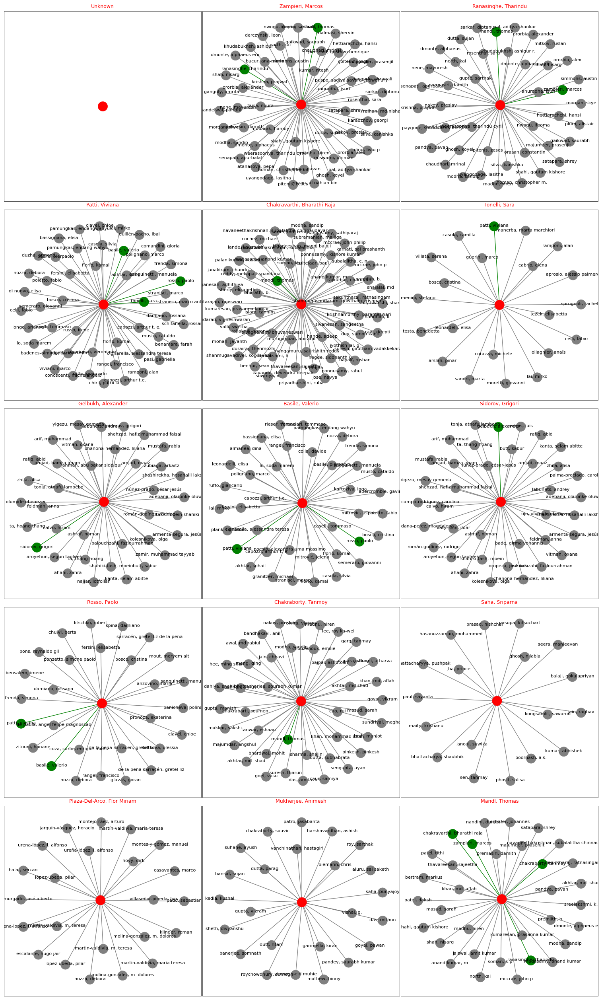

In [59]:
# Arguments:
# entry      = 'aut', 'cout', 'inst', 'kwa', or 'kwp'.
# tgt        = List of specific names.
# topn       = Integer. Specifies the number of top authors to display based on their total contributions.
# rows       = Integer. Defines the number of rows in the subplot grid for the visual layout.
# cols       = Integer. Defines the number of columns in the subplot grid for the visual layout.
# wspace     = Float. Adjusts horizontal spacing between subplots.
# hspace     = Float. Adjusts vertical spacing between subplots.
# tspace     = Float. Sets additional vertical space between nodes and labels for better readability.
# node_size  = Integer. Controls the size of each node in the network graph.
# font_size  = Integer. Defines the font size for node labels.
# pad        = Float. Adjusts padding around the layout for a balanced appearance.
# nd_a       = Color string (e.g., '#FF0000'). Specifies the color for the primary node (main author).
# nd_b       = Color string (e.g., '#008000'). Specifies the color for secondary nodes (authors with significant links).
# nd_c       = Color string (e.g., '#808080'). Specifies the color for other nodes (authors with minor links).
# verbose    = Boolean. If True, prints details of each main node and its connections in the console; if False, suppresses this output.
bibfile.network_collab( entry     = 'aut',
                        tgt       = [],
                        topn      = 15,
                        rows      = 5,
                        cols      = 3,
                        wspace    = 0.2,
                        hspace    = 0.2,
                        tspace    = 0.01,
                        node_size = 300,
                        font_size = 8,
                        pad       = 0.2,
                        nd_a      = '#FF0000',
                        nd_b      = '#008000',
                        nd_c      = '#808080',
                        verbose   = True)

In [60]:
print(bibfile.ask_gpt_ct)

[[['unknown'], []], [['zampieri, marcos'], ['anuradha, isuri', 'atanasova, pepa', 'bucur, ana-maria', 'chaudhari, mrinal', 'derczynski, leon', 'dinu, liviu p.', 'dmonte, alphaeus', 'dmonte, alphaeus eric', 'dutta, sujan', 'emran, al nahian bin', 'farra, noura', 'gaikwad, saurabh', 'ganguly, amrita', 'ghosh, koyel', 'goswami, dhiman', 'gupte, sarthak', 'hettiarachchi, hansi', 'homan, christopher m.', 'karadzhov, georgi', 'khandelwal, paridhi', 'khudabukhsh, ashiqur r.', 'krishna, prajwal', 'kumar, ritesh', 'madhu, hiren', 'majumder, prasenjit', 'malmasi, shervin', 'mandl, thomas', 'modha, sandip', 'morgan, skye', 'mubarak, hamdy', 'nakov, preslav', 'nene, mayuresh', 'north, kai', 'nwogu, ifeoma', 'ororbia, alex', 'ororbia, alexander', 'paetzold, gustavo henrique', 'pal, aditya shankar', 'pandya, pavan', 'paygude, shrunali', 'pitenis, zeses', 'premasiri, damith', 'puspo, sadiya sayara chowdhury', 'raihan, md nishat', 'ranasinghe, tharindu', 'rosenthal, sara', 'sarkar, diptanu', 'satapara

In [61]:
# Network - Citation Analisys Between Documents (Blue Nodes) and Citations (Red Nodes).  (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            min_count   = Relationship between nodes that have been cited at least x times;
#            node_labels = True or False (True -> The label IDs will be displayed, False -> Only the nodes will be displayed );
#            node_size   = Integer. Value for node size;
#            font_size   = Integer. Defines the font size for node labels;
#            local_nodes = True or False (True -> Only the blue will be displayed, False -> Red and Blue nodes will be displayed)
bibfile.network_adj_dir(view = 'notebook', min_count = 10, node_labels = True, node_size = 20, local_nodes = False)

In [62]:
# View Table
data_nad = bibfile.ask_gpt_nad
data_table.DataTable(data_nad, num_rows_per_page = 15)

,Paper,Cited Reference
0,3215,r_150
1,3215,r_354
2,3215,r_445
3,3215,r_1094
4,3215,r_1403
...,...,...
919,3373,r_3038
920,3373,r_4429
921,3373,r_4441
922,3373,r_4552


In [63]:
# Network - Highlight Citation Analysis Between Documents (Blue Nodes) and Citations (Red Nodes).  (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            article_ids = A list of Blue Nodes. It indicates the documents cited by them;
#            ref_ids     = A list of Red Nodes. It indicates the documents that cites them;
#            font_size   = Integer. Defines the font size for node labels;
#            node_size   = Integer. Value for node size
bibfile.find_nodes_dir(view = 'notebook', article_ids = [], ref_ids = [], node_size = 20)

In [64]:
# Network - Highlight Citation Analysis Between Documents (Blue Nodes) and Citations (Red Nodes).  (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            article_ids = A list of Blue Nodes. It indicates the documents cited by them;
#            ref_ids     = A list of Red Nodes. It indicates the documents that cites them;
#            font_size   = Integer. Defines the font size for node labels;
#            node_size   = Integer. Value for node size
bibfile.find_nodes_dir(view = 'notebook', article_ids = [], ref_ids = ['r_4682'], node_size = 20)

In [65]:
# Network - Highlight Citation Analysis Between Documents (Blue Nodes) and Citations (Red Nodes).  (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            article_ids = A list of Blue Nodes. It indicates the documents cited by them;
#            ref_ids     = A list of Red Nodes. It indicates the documents that cites them
bibfile.find_nodes_dir(view = 'notebook', article_ids = [], ref_ids = ['r_4682'])

In [66]:
# Network - Local Documents (Only Blue Nodes) Citation History. (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            min_links   = Relationship between nodes that have connected at least x times;
#            node_size   = Integer. Value for node size;
#            font_size   = Integer. Defines the font size for node labels;
#            node_labels = True or False (True -> The label IDs will be displayed, False -> Only the nodes will be displayed );
#            chain       = A list of documents. It shows the documents and their citations;
#            path       =  Only relevant if 'chain' is not empty. True -> Show only the documents in 'chain'. False -> Show documents and connections.
citations = bibfile.network_hist(view = 'notebook', min_links = 0, chain = [], path = False, node_size = 20, node_labels = True)

In [67]:
# View Table
data_hist = bibfile.ask_gpt_hist
data_table.DataTable(data_hist, num_rows_per_page = 15)

,Paper ID (Year),Reference ID (Year)
0,3215 (2022),3233 (2021)
1,3217 (2024),3233 (2021)
2,3221 (2024),3222 (2020)
3,3228 (2022),3137 (2013)
4,3230 (2022),3222 (2020)
...,...,...
59,3363 (2024),3241 (2022)
60,3363 (2024),3233 (2021)
61,3364 (2024),1237 (2023)
62,3366 (2024),3290 (2023)


In [68]:
citations = bibfile.network_hist(view = 'notebook', min_links = 0, chain = [21, 208], path = False, node_size = 20, node_labels = True)

In [69]:
citations = bibfile.network_hist(view = 'notebook', min_links = 0, chain = [], path = True, node_size = 20, node_labels = True)

In [70]:
# Network - Analyze Hist. Citations
# Arguments: min_path_size = Minimum number of elements of a path.
hist_paths = bibfile.analyze_hist_citations(citations, min_path_size = 2)

Most Referenced Paper ID: 3233 -> Cited 19 Times
Paper ID that Cites the Most: 3332 -> Cites 9 Papers
Paper IDs of Longest Citation Path: [3287, 3332, 3290, 3233, 2661]


In [71]:
# Network - Collaboration Analysis Between Authors, Countries, Intitutions Or Adjacency Analysis Between Authors' Keywords or Keywords Plus. (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            adj_type    = 'aut', 'cout', 'inst', 'kwa', or 'kwp'
#            min_count   = Relationship between nodes that have connected at least x times;
#            node_labels = True or False (True -> The label IDs will be displayed, False -> Only the nodes will be displayed );
#            node_size   = -1. (If node_size = -1 then the default value will be used. If node_size > 0 then this new value will be used);
#            label_type  = 'id', 'name' (Only meaningfull if node_labels = True. 'id' -> The ID will be displayed; 'name' -> The name will be displayed);
#            centrality  = 'degree', 'load', 'betw', 'close', 'eigen', 'katz', 'harmonic', or None. Color nodes according to centrality criterion
#                          'degree'   = Degree Centrality
#                          'load'     = Load Centrality
#                          'betw'     = Betweenness Centrality
#                          'close'    = Closeness Centrality
#                          'eigen'    = Eigenvector Centrality
#                          'katz'     = Katz Centrality
#                          'harmonic' = Harmonic Centrality
#                           None      = The Community Algorithm, Girvan-Newman, will be used Instead of a Centrality Criterion
bibfile.network_adj(view = 'notebook', adj_type = 'aut', min_count = 3, node_labels = True, label_type = 'name', centrality = None)

# PS: If a centrality criterion is used then the values can be obtained by the following command:  bibfile.table_centr

/usr/local/lib/python3.11/dist-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning:

Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.



In [72]:
# View Table
data_adj = bibfile.ask_gpt_adj
data_table.DataTable(data_adj, num_rows_per_page = 15)

,Node 1 (Author),Node 2 (Author),Node 1 Cluster,Node 2 Cluster
0,ID: a_1,ID: a_999,0.0,0.0
1,ID: a_1,ID: a_1340,0.0,0.0
2,ID: a_1,ID: a_1650,0.0,0.0
3,ID: a_1,ID: a_1655,0.0,0.0
4,ID: a_1,ID: a_1697,0.0,0.0
...,...,...,...,...
16244,ID: a_8594,ID: a_8642,507.0,507.0
16245,ID: a_8602,ID: a_8610,3.0,3.0
16246,ID: a_8604,ID: a_8613,247.0,247.0
16247,ID: a_8666,ID: a_8668,25.0,25.0


In [73]:
# Network - Highlight  Collaboration Analysis Between Authors, Countries, Intitutions Or Adjacency Analysis Between Authors' Keywords or Keywords Plus. (An interactive plot).
# Arguments: view      = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            node_ids  = A list of IDs. Only meaningfull if label_type = 'id';
#            node_name = A list of Names. Only meaningfull iflabel_type = 'name';
#            node_only = True or False (True -> Only the Node will be Highlighted, False -> Node and its Connections will be Highlighted)
bibfile.find_nodes(node_ids = [], node_name = [], node_only = False)

In [74]:
# Network - Similarity Analysis using coupling or cocitation methods. (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            sim_type    = 'coup', 'cocit' ('coup' -> Coupling Method, 'cocit' -> Cocitation Method)
#            node_size   = -1. (If node_size = -1 then the default value will be used. If node_size > 0 then this new value will be used);
#            node_labels = True or False (True -> The label IDs will be displayed, False -> Only the nodes will be displayed );
#            cut_coup    = Cutoff value for Coupling Method. Only meaninfull if sim_type = 'coup';
#            cut_cocit   = Cutoff value for Cocitation Method. Only meaninfull if sim_type = 'cocit'
bibfile.network_sim(view = 'notebook', sim_type = 'cocit', node_size = 10, node_labels = True, cut_coup = 0.3, cut_cocit = 10)

In [75]:
# Check Similarity Values
data_table.DataTable(bibfile.sim_table, num_rows_per_page = 15)

,Pair Node,Sim(cocit)
0,"(3215,3233)",10.0
1,"(3215,3247)",34.0
2,"(3215,3290)",11.0
3,"(3216,3253)",13.0
4,"(3218,3236)",10.0
...,...,...
111,"(3331,3332)",10.0
112,"(3338,3364)",10.0
113,"(3339,3345)",15.0
114,"(3346,3367)",12.0


In [76]:
# Network - Collaboration Analysis Between Countries using a Map. (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            connections = True or False (True -> Countries connections will be displayed, False -> Countries connections will not be displayed);
#            country_lst = Highlight the Connections Between a List of Countries
bibfile.network_adj_map(view = 'notebook', connections = True, country_lst = [])

/usr/local/lib/python3.11/dist-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning:

Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.



In [77]:
# View Table
data_map = bibfile.ask_gpt_map
data_table.DataTable(data_map, num_rows_per_page = 15)

,Country 1,Country 2
0,Sudan,Saudi Arabia
1,Sudan,Malaysia
2,Sudan,Niger
3,Ghana,Ghana
4,Eritrea,India
...,...,...
761,Australia,Hungary
762,Australia,Georgia
763,Australia,Brazil
764,Australia,Bangladesh


In [78]:
# Network - Collaboration Analysis Between Countries using a Map. (An interactive plot).
# Arguments: view        = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window);
#            connections = True or False (True -> Countries connections will be displayed, False -> Countries connections will not be displayed);
#            country_lst = Highlight the Connections Between a List of Countries
bibfile.network_adj_map(view = 'notebook', connections = False, country_lst = [])

/usr/local/lib/python3.11/dist-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning:

Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.



# Artificial Intelligence Analysis
---
In this section, we will perform AI Analysis

In [79]:
# NLP
# Arguments: corpus_type       = 'abs', 'title', 'kwa', or 'kwp';
#            stop_words        = A list of stopwords to clean the corpus. ['ar', 'bn', 'bg', 'cs', 'en', 'fi', 'fr', 'de', 'el', 'hi', 'he', 'hu', 'it', 'ja', 'ko',  'mr', 'fa', 'pl', 'pt-br', 'ro', 'ru', 'es', 'sv', 'sk', 'zh', 'th', 'uk'];
#                                'ar' = Arabic; 'bn' = Bengali; 'bg' = Bulgarian; 'cs' = Czech; 'en' = English; 'fi' = Finnish; 'fr' = French; 'de' = German; 'el' = Greek; 'he' = Hebrew;'hi' = Hindi; 'hu' = Hungarian; 'it' = Italian;
#                                'ja' = Japanese; 'ko' = Korean; 'mr' =  Marathi; 'fa' =  Persian; 'pl' =  Polish; 'pt-br' = Potuguese-Brazilian; 'ro' = Romanian; 'ru' = Russian; 'es' =  Spanish; 'sk' = Slovak; 'sv' = Swedish;
#                                'zh' = Chinese; 'th' = Thai; 'uk' = Ukrainian
#            rmv_custom_words  = A list of custom stopwords to clean the corpus;
#            model             = Specifies the used AI model. The default value is 'allenai/scibert_scivocab_uncased'
bibfile.create_embeddings(stop_words = ['en'], rmv_custom_words = [], corpus_type = 'abs', model = 'allenai/scibert_scivocab_uncased')
emb = bibfile.embds

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/442M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/442M [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/228k [00:00<?, ?B/s]

In [80]:
# NLP #-1 refers to all outliers and should typically be ignored.
# Arguments: stop_words        = A list of stopwords to clean the corpus. ['ar', 'bn', 'bg', 'cs', 'en', 'fi', 'fr', 'de', 'el', 'hi', 'he', 'hu', 'it', 'ja', 'ko',  'mr', 'fa', 'pl', 'pt-br', 'ro', 'ru', 'es', 'sv', 'sk', 'zh', 'th', 'uk'];
#                              'ar' = Arabic; 'bn' = Bengali; 'bg' = Bulgarian; 'cs' = Czech; 'en' = English; 'fi' = Finnish; 'fr' = French; 'de' = German; 'el' = Greek; 'he' = Hebrew;'hi' = Hindi; 'hu' = Hungarian; 'it' = Italian;
#                              'ja' = Japanese; 'ko' = Korean; 'mr' =  Marathi; 'fa' =  Persian; 'pl' =  Polish; 'pt-br' = Potuguese-Brazilian; 'ro' = Romanian; 'ru' = Russian; 'es' =  Spanish; 'sk' = Slovak; 'sv' = Swedish;
#                              'zh' = Chinese; 'th' = Thai; 'uk' = Ukrainianian;   'es' =  Spanish;  'sv' = Swedish
#            rmv_custom_words  = A list of custom stopwords to clean the corpus;
#            embeddings        = True or False. If True then word embeddings are used to create the topics
#            model             = Specifies the used AI model. The default value is 'allenai/scibert_scivocab_uncased'
bibfile.topics_creation(stop_words = ['en'], rmv_custom_words = [], embeddings = False, model = 'allenai/scibert_scivocab_uncased')

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.5k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

    Topic  Count                                      Name  \
0      -1   1374            -1_hate_speech_language_social   
1       0    347            0_hate_speech_detection_models   
2       1    206     1_cyberbullying_social_bullying_media   
3       2    162     2_violent_violence_video_surveillance   
4       3    156         3_toxic_toxicity_comments_comment   
5       4     90           4_based_learning_papers_include   
6       5     76            5_hate_speech_indonesian_media   
7       6     64               6_hate_speech_social_online   
8       7     64    7_cyberbullying_learning_deep_accuracy   
9       8     58            8_arabic_speech_hate_religious   
10      9     57        9_abusive_language_detection_abuse   
11     10     48            10_memes_meme_multimodal_image   
12     11     46           11_violent_audio_violence_video   
13     12     44            12_subtask_hasoc_hindi_english   
14     13     43                   13_bert_speech_hate_mwe   
15     1

In [81]:
# Authors Production per Topic
production_topics = bibfile.topics_authors(topn = 15)
production_topics

,-1,0,1,2,3,4,5,6,7,8,...,31,32,33,34,35,36,37,38,39,Total
unknown,473,93,16,7,35,75,12,9,2,5,...,5,15,12,0,2,1,7,10,5,1059
"zampieri, marcos",21,1,0,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,31
"ranasinghe, tharindu",20,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,27
"patti, viviana",16,2,0,0,0,0,0,0,0,0,...,0,0,2,0,0,0,0,0,0,26
"chakravarthi, bharathi raja",9,1,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,4,0,22
"tonelli, sara",10,1,2,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,19
"gelbukh, alexander",13,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,19
"basile, valerio",14,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,19
"sidorov, grigori",12,2,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,18
"rosso, paolo",9,3,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,18


In [82]:
# NLP
# Each document Topic
topics = bibfile.topics

In [83]:
# NLP
# Each document Probability to belong a Topic
probs = bibfile.probs

In [84]:
# NLP
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window)
bibfile.graph_topics_distribution(view = 'notebook')

In [85]:
# NLP
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window)
bibfile.graph_topics(view = 'notebook')

In [86]:
def generate_detailed_topic_table(data, num_topics=15, words_per_topic=8):
    """
    Generates a table with Topic ID, Descriptive Topic Phrase (8 words),
    and the top representative keywords.
    """
    try:
        topic_info = data.topic_model.get_topic_info()

        table = PrettyTable()
        table.field_names = ["Topic ID", "Descriptive Topic (8 words)", "Common Keywords"]
        table.align = "l"
        table.max_width = 40

        for topic_row in topic_info.itertuples():
            if topic_row.Index == -1:  # Skip outliers
                continue

            if len(table.rows) >= num_topics:
                break

            # Get topic words (more than 4 — we'll use 8 for richness)
            topic_words = [word[0] for word in data.topic_model.get_topic(topic_row.Topic)[:words_per_topic]]
            topic_desc = ", ".join(topic_words)

            # Extract keywords from top documents in the topic
            doc_indices = [i for i, t in enumerate(data.topics) if t == topic_row.Topic]
            keywords = set()

            for idx in doc_indices[:5]:  # Take more docs to extract good keywords
                doc = data.data.iloc[idx]

                if isinstance(doc.get('keywords'), str):
                    doc_keywords = doc['keywords'].split('; ')
                    keywords.update(k.strip() for k in doc_keywords if k.strip())

            # Add row to table
            table.add_row([
                topic_row.Topic,
                topic_desc,
                ", ".join(sorted(keywords)[:5]) if keywords else "N/A"
            ])

        print(f"\nExtended Topic-Keyword Table (Top {num_topics} Topics):")
        print(table)

        # Optionally save or return as DataFrame
        df = pd.DataFrame({
            'Topic_ID': [row[0] for row in table.rows],
            'Topic_Description_8_Words': [row[1] for row in table.rows],
            'Representative_Keywords': [row[2] for row in table.rows]
        })

        return df

    except Exception as e:
        print(f"Error generating detailed topic table: {str(e)}")
        return None

detailed_topic_table = generate_detailed_topic_table(bibfile, num_topics=15, words_per_topic=8)

# Save to CSV if needed
if detailed_topic_table is not None:
    detailed_topic_table.to_csv('detailed_topic_keywords_table.csv', index=False)
    print("\nSaved as 'detailed_topic_keywords_table.csv'")



Extended Topic-Keyword Table (Top 15 Topics):
+----------+------------------------------------------+------------------------------------------+
| Topic ID | Descriptive Topic (8 words)              | Common Keywords                          |
+----------+------------------------------------------+------------------------------------------+
| -1       | hate, speech, language, social,          | Annotated datasets, Benchmark datasets,  |
|          | offensive, media, model, detection       | COVID-19, Deep learning, Discourse       |
| 0        | hate, speech, detection, models,         | Adversarial machine learning, Ambient    |
|          | learning, deep, model, data              | intelligence, Bi-LSTM, College students, |
|          |                                          | Community OR                             |
| 1        | cyberbullying, social, bullying, media,  | Adversarial machine learning, Analysis   |
|          | detection, machine, research, online     | models

In [106]:
# Required Libraries
from bertopic import BERTopic
import pandas as pd
from tabulate import tabulate

# Load your saved BERTopic model
topic_model = BERTopic.load("my_topic_model")

# Extract detailed topic information
topic_info = topic_model.get_topic_info()

# Prepare topics with individual keywords and their 5-word phrases
topics_list = []

for topic_id in topic_info['Topic']:
    if topic_id == -1:  # explicitly exclude outliers
        continue
    topic_keywords = topic_model.get_topic(topic_id)

    # Extract top 5 keywords explicitly
    top_keywords = [word for word, _ in topic_keywords[:5]]
    keywords_str = ', '.join(top_keywords)
    phrase_str = ' '.join(top_keywords)

    topics_list.append({
        'Topic ID': topic_id,
        'Top 5 Keywords': keywords_str,
        'Representative Phrase (5 words)': phrase_str
    })

# Display clearly as a table
topics_df = pd.DataFrame(topics_list)
print(tabulate(topics_df, headers='keys', tablefmt='psql'))


+----+------------+----------------------------------------------------+------------------------------------------------+
|    |   Topic ID | Top 5 Keywords                                     | Representative Phrase (5 words)                |
|----+------------+----------------------------------------------------+------------------------------------------------|
|  0 |          0 | hate, speech, detection, models, learning          | hate speech detection models learning          |
|  1 |          1 | cyberbullying, social, bullying, media, detection  | cyberbullying social bullying media detection  |
|  2 |          2 | violent, violence, video, surveillance, behavior   | violent violence video surveillance behavior   |
|  3 |          3 | toxic, toxicity, comments, comment, online         | toxic toxicity comments comment online         |
|  4 |          4 | based, learning, papers, include, machine          | based learning papers include machine          |
|  5 |          5 | hate

In [87]:
# NLP
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window)
bibfile.graph_topics_projection(view = 'notebook')

In [88]:
# NLP
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window)
bibfile.graph_topics_heatmap(view = 'notebook')

In [89]:
# NLP
# Arguments: view = 'notebook', 'browser' ('notebook' -> To plot in your prefered Notebook App. 'browser' -> To plot in your prefered browser window)
bibfile.graph_topics_time(view = 'notebook')

In [90]:
# NLP
bibfile.topics_representatives()

,Topic,Docs
0,-1.0,
1,0.0,474; 1027; 1156
2,1.0,1105; 3317; 3077
3,2.0,2847; 11; 890
4,3.0,3292; 393; 198
5,4.0,1318; 266; 1342
6,5.0,1152; 2332; 1117
7,6.0,3141; 2969; 3057
8,7.0,670; 1820; 1053
9,8.0,767; 1184; 892


In [91]:
# NLP
similar_topics, similarity = bibfile.topic_model.find_topics('electre', top_n = 10)
for i in range(0, len(similar_topics)):
  print('Topic: ', similar_topics[i], 'Correlation: ', round(similarity[i], 3))

Topic:  20 Correlation:  0.122
Topic:  17 Correlation:  0.117
Topic:  18 Correlation:  0.113
Topic:  15 Correlation:  0.106
Topic:  19 Correlation:  0.106
Topic:  32 Correlation:  0.098
Topic:  28 Correlation:  0.092
Topic:  12 Correlation:  0.092
Topic:  21 Correlation:  0.091
Topic:  33 Correlation:  0.088


In [92]:
# NLP
# Arguments: doc_id = Article ID. For the specified article, this function evaluates how each word in its abstract semantically aligns with all topics in the model.
df = bibfile.topics_words(doc_id = 42)

In [94]:
# NLP
bibfile.topic_model.save('my_topic_model')
#loaded_topic_model = BERTopic.load('my_topic_model')

2025-04-13 10:38:58,189 - BERTopic - WARNING: When you use `pickle` to save/load a BERTopic model,please make sure that the environments in which you saveand load the model are **exactly** the same. The version of BERTopic,its dependencies, and python need to remain the same.


In [95]:
# W2V
model, corpus, w_emb, vocab = bibfile.word_embeddings(stop_words        = ['en'],
                                                      lowercase         = True,
                                                      rmv_accents       = True,
                                                      rmv_special_chars = False,
                                                      rmv_numbers       = True,
                                                      rmv_custom_words  = [],
                                                      vector_size       = 100,
                                                      window            = 5,
                                                      min_count         = 1,
                                                      epochs            = 10)

In [96]:
# W2V - Similarity
similarity = bibfile.word_embeddings_sim(model, word_1 = 'mcda', word_2 = 'risk')
similarity

0.044173073

In [97]:
# W2V - Find Docs
results = bibfile.word_embeddings_find_doc(corpus, target_words = ['mcda', 'risk'])
results

[]

In [98]:
# W2V - Operations
operations = bibfile.word_embeddings_operations(model, positive = ['mcda', 'group'], negative = ['risk'], topn = 10)
operations

[('greek', 0.8335554003715515),
 ('simhash', 0.8247606158256531),
 ('doubt', 0.8237764239311218),
 ('kauno', 0.8187313675880432),
 ('otam', 0.8165620565414429),
 ('itma', 0.8089513778686523),
 ('hi', 0.8083148002624512),
 ('gec', 0.7958441376686096),
 ('cda', 0.790039598941803),
 ('gecc', 0.7882105708122253)]

In [99]:
# W2V - Operations Plot.
bibfile.plot_word_embeddings(model,
                             view      = 'notebook',
                             positive  = [ ['mcda', 'group'], ['decision'],             ['group']],
                             negative  = [ ['risk'],          ['research', 'analysis'], []       ],
                             topn      = 5,
                             node_size = 10,
                             font_size = 14)

In [100]:
# NLP - Abstractive Summarization
# Arguments: article_ids = A list of documents to perform an abstractive summarization with the available abstracts. If the list is empty then all documents will be used
#            model_name  = Available pre-trained models. Complete list is available at  https://huggingface.co/models?pipeline_tag=summarization&sort=downloads&search=pegasus
abs_summary = bibfile.summarize_abst_peg(article_ids = [171, 184, 98], model_name = 'google/pegasus-xsum')


Total Number of Valid Abstracts:  3



tokenizer_config.json:   0%|          | 0.00/87.0 [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/1.91M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/65.0 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/3.52M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.39k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.28G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.28G [00:00<?, ?B/s]

Some weights of PegasusForConditionalGeneration were not initialized from the model checkpoint at google/pegasus-xsum and are newly initialized: ['model.decoder.embed_positions.weight', 'model.encoder.embed_positions.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


generation_config.json:   0%|          | 0.00/259 [00:00<?, ?B/s]

In [101]:
# NLP - Check Abstractive Summarization
print(textwrap.fill(abs_summary, 150))

A novel F3DNN-Net has been proposed for violent incidents detection in images, and a novel algorithm has been employed to detect objects within pre-
processed frames. The Yolov8 (You Only Look Once) algorithm is employed to detect objects within pre-processed frames., the ego algorithm is applied
to the pre-processed images., the work is published in the Journal of the American Academy of Arts and Sciences, Volume 2, Issue 2, March 2016., et
al., 2016.


In [ ]:
# NLP - Abstractive Summarization - chatGPT

# OBS 1: Requires the user to have an **API key** (https://platform.openai.com/account/api-keys))
# OBS 2: The limit of characters is 4097 per request

# Arguments: article_ids   = A list of documents to perform an abstractive summarization with the available abstracts. If the list is empty then all documents will be used
#            join_articles = If False then the abstracts will be analyzed separately. If True then the abstracts will be concate in a single text
#            api_key       = 'your_api_key_here'. Insert your personal API key (https://platform.openai.com/account/api-keys)
#            model         = Specifies the AI model used for text generation. The default value is "text-davinci-003"
#            query         = Ask chatGPT what you want to do with the abstracts. The default query is: 'from the following scientific abstracts, summarize the main information in a single paragraph using around 250 words'
abs_summary_chat = bibfile.summarize_abst_chatgpt(article_ids = [1,2], join_articles = True, api_key = 'your_api_key_here', query = 'from the following scientific abstracts, summarize the main information in a single paragraph using around 250 words', model = 'gpt-4')

In [ ]:
# NLP - Check Abstractive Summarization
print(textwrap.fill(abs_summary_chat, 250))

In [ ]:
# NLP - Extractive Summarization
# Arguments: article_ids = A list of documents to perform an extractive summarization with the available abstracts. If the list is empty then all documents will be used
ext_summary = bibfile.summarize_ext_bert(article_ids = [1, 2])

In [ ]:
# NLP - Check Extractive Summarization
print(textwrap.fill(ext_summary, 150))

# Correction and Data Manipulation
---
In this section, we will show how to Correct & Manipulate your Data

In [102]:
# Filter the .bib File
# Arguments: document = A list of documents to retain. The other documents will be deleted
#            doc_type = A list of doc types. Check the 'report' to select the available types;
#            year_str = An integer the determines the starting year of collection -1 = All years;
#            year_end = An integer the determines the ending year of collection   -1 = All years;
#            sources  = A list of sources. Check the cell '# Check Sources IDs' to select the available types;
#            core     = A integer (-1, 1, 2, 3, 12, or 23) -1 = All sources, 1 = Bradford core 1, 2 = Bradford core 2, 3 = Bradford core 3, 12 = Bradford core 1 and 2, 23 = Bradford core 2 and 3;
#            country  = A list of countries. Check the cell '# Check Countries IDs' to select the available types;
#            language = A list of languages. Check the 'report' to select the available types
#            abstract = True or False. True removes UNKNOW values from the abstract.
bibfile.filter_bib(documents = [], doc_type = [], year_str = -1, year_end = -1, sources = [], core = -1, country = [], language = [], abstract = False)

A Total of 3374 Documents Remains

Article = 751
Article in Press = 10
Article; Retracted Publication = 1
Book = 5
Book chapter = 72
Conference paper = 2241
Conference review = 155
Proceedings Paper = 106
Retracted = 1
Review = 32


In [103]:
# Correct the .bib File
# Arguments: get         = A list of the current name(s);
#            replace_for = A string. This string will replace all matchs from the 'get' argument list
bibfile.merge_author(get = [], replace_for = 'name')
bibfile.merge_institution(get = [], replace_for = 'name')
bibfile.merge_country(get = [], replace_for = 'name')
bibfile.merge_language(get = [], replace_for = 'name')
bibfile.merge_source(get = [], replace_for = 'name')
bibfile.merge_reference(get = [], replace_for = 'name')

In [ ]:
# Work with modified .bib File

# 1) Input a .bib to instantiate a class => bibfile  = pbx_probe(file_bib = file_name, db = database, del_duplicated = True)
# 2) Then made the modifications and save the data externally => bibfile.save_database(sep = '\t', name = 'data.csv')
# 3) To load the modified .bib file ( 'data.csv') => bibfile.load_database(name = 'data.csv')

# PS: Even with the saved 'data.csv', you always need to do step 1, so to be fast, have any small .bib file in hand.
# Then, you can go directly to step 3, and your saved .bib ('data.csv') will replace the small .bib